In [37]:
#  Copyright (c) 2024.
#  ProrokLab (https://www.proroklab.org/)
#  All rights reserved.

from __future__ import annotations

import torch
from tensordict import TensorDict
from torch import nn
from torchrl.modules import MultiAgentMLP
from het_control.snd import compute_behavioral_distance
from het_control.utils import overflowing_logits_norm
from smac.env import StarCraft2Env
import numpy as np
import matplotlib.pyplot as plt
import wandb


class HetControlMlpEmpirical(nn.Module):
    """
    Empirical DiCo policy model adapted to SMAC (no external dependencies).

    Parameters:
        input_dim (int): dimension of each agent's observation vector.
        n_agents (int): number of agents in the environment.
        output_dim (int): number of action logits per agent.
        activation_class (Type[nn.Module]): activation to use in MLP layers.
        num_cells (List[int]): hidden layer sizes for the shared and per-agent MLPs.
        desired_snd (float): target Social Novelty Distance; guides diversity scaling.
        probabilistic (bool): if True, outputs include action distribution parameters.
        tau (float): soft-update rate for estimated SND.
        bootstrap_from_desired_snd (bool): if True, initializes estimated SND to desired on first step.
        process_shared (bool): unused here.
    """
    def __init__(
        self,
        input_dim: int,
        n_agents: int,
        output_dim: int,
        activation_class: type[nn.Module],
        num_cells: list[int],
        desired_snd: float,
        probabilistic: bool,
        tau: float,
        bootstrap_from_desired_snd: bool,
        process_shared: bool,
    ):
        super().__init__()
        self.n_agents = n_agents
        self.probabilistic = probabilistic
        self.tau = tau
        self.bootstrap_from_desired_snd = bootstrap_from_desired_snd
        self.process_shared = process_shared

        self.register_buffer("desired_snd", torch.tensor([desired_snd], dtype=torch.float))
        self.register_buffer("estimated_snd", torch.tensor([float('nan')], dtype=torch.float))

        self.shared_mlp = MultiAgentMLP(
            n_agent_inputs=input_dim,
            n_agent_outputs=output_dim,
            n_agents=n_agents,
            centralised=False,
            share_params=True,
            activation_class=activation_class,
            num_cells=num_cells,
        )
        agent_outputs = output_dim // 2 if probabilistic else output_dim
        self.agent_mlps = MultiAgentMLP(
            n_agent_inputs=input_dim,
            n_agent_outputs=agent_outputs,
            n_agents=n_agents,
            centralised=False,
            share_params=False,
            activation_class=activation_class,
            num_cells=num_cells,
        )

    def forward(
        self,
        observations: torch.Tensor,
    ) -> torch.Tensor:
        shared_out = self.shared_mlp(observations)
        agent_out = self.agent_mlps(observations)
        if self.desired_snd.item() > 0 and self.n_agents > 1:
            distance = self._estimate_snd(observations)
            # ensure scalar
            distance = distance.mean()
            self.estimated_snd[0] = distance.detach()
        else:
            distance = self.estimated_snd[0]
        if self.desired_snd.item() == 0:
            scaling = 0.0
        else:
            scaling = (self.desired_snd[0] / distance).item() if not torch.isnan(distance) else 1.0
        if self.probabilistic:
            loc, scale = shared_out.chunk(2, -1)
            loc = loc + agent_out * scaling
            out = torch.cat([loc, scale], dim=-1)
        else:
            out = shared_out + agent_out * scaling
        return out

    def _estimate_snd(self, obs: torch.Tensor) -> torch.Tensor:
        all_out = self.agent_mlps(obs)
        actions = [all_out[:, i, :] for i in range(self.n_agents)]
        dist = compute_behavioral_distance(actions, just_mean=True)
        if torch.isnan(self.estimated_snd):
            return dist if not self.bootstrap_from_desired_snd else self.desired_snd
        return (1 - self.tau) * self.estimated_snd + self.tau * dist


def render_snd_heatmap(env: StarCraft2Env, model: HetControlMlpEmpirical) -> plt.Figure:
    obs = env.get_obs()
    obs_tensor = torch.tensor(np.stack(obs), dtype=torch.float32).unsqueeze(0)
    dev_out = model.agent_mlps(obs_tensor).squeeze(0)
    n_agents = env.get_env_info()['n_agents']
    dist_matrix = torch.zeros((n_agents, n_agents), dtype=torch.float32)
    for i in range(n_agents):
        for j in range(n_agents):
            d = compute_behavioral_distance([dev_out[i], dev_out[j]], just_mean=True)
            dist_matrix[i, j] = d.item()
    fig, ax = plt.subplots()
    cax = ax.imshow(dist_matrix.numpy(), interpolation='nearest')
    ax.set_title('Behavioral Distance Matrix')
    fig.colorbar(cax, ax=ax)
    plt.close(fig)
    return fig



def train_reinforce(env: StarCraft2Env,
                     model: HetControlMlpEmpirical,
                     config: dict):
    """
    Simplified REINFORCE training loop for HetControlMlpEmpirical on SMAC.
    """
    lr = config.get('lr', 2.5e-4)
    gamma = config.get('gamma', 0.99)
    max_episodes = config.get('num_episodes', 100)
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)

    for ep in range(1, max_episodes + 1):
        env.reset()
        obs = env.get_obs()
        done = False
        rewards = []
        logps = []
        total_reward = 0.0

        while not done:
            obs_tensor = torch.tensor(np.stack(obs), dtype=torch.float32).unsqueeze(0)
            logits = model(obs_tensor)             # [1, n_agents, output_dim]
            # sample per agent
            actions = []
            step_logp = []
            for i in range(env.get_env_info()['n_agents']):
                logit_i = logits[0, i]
                # create masked logits without in-place operation
                avail = env.get_avail_agent_actions(i)
                mask = torch.tensor(avail, dtype=torch.bool, device=logit_i.device)
                masked_logits = logit_i.masked_fill(~mask, float('-1e9'))
                dist = torch.distributions.Categorical(logits=masked_logits)
                a = dist.sample()
                step_logp.append(dist.log_prob(a))
                actions.append(a.item())
            action = actions  # list
            logp_sum = torch.stack(step_logp).sum()

            reward, done, _ = env.step(action)
            rewards.append(reward)
            logps.append(logp_sum)
            total_reward += reward
            obs = env.get_obs()

        # compute discounted returns
        returns = []
        R = 0
        for r in reversed(rewards):
            R = r + gamma * R
            returns.insert(0, R)
        returns = torch.tensor(returns, dtype=torch.float32)
        # normalize
        returns = (returns - returns.mean()) / (returns.std() + 1e-8)

        # policy gradient update
        loss = 0
        for logp, R in zip(logps, returns):
            loss += -logp * R
        loss = loss / len(logps)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        # Log metrics to W&B including SND and behavioral heatmap
        wandb.log({'episode_reward': total_reward,
                   'policy_loss': loss.item(),
                   'episode': ep,
                   'snd_estimate': model.estimated_snd[0].item()})
        # Generate and log heatmap image
        fig = render_snd_heatmap(env, model)
        wandb.log({'behavioral_distance_heatmap': wandb.Image(fig), 'episode': ep})
        render_snd_heatmap(env, model)

    env.close()
    wandb.finish()


def main():
    # Initialize W&B
    config = {
        'num_cells': [64, 64],
        'desired_snd': 1.0,
        'probabilistic': False,
        'tau': 0.1,
        'num_episodes': 2000,
        'lr': 2.5e-4,
    }
    wandb.init(project='smac_het_control', config=config)

    env = StarCraft2Env(map_name='8m')
    info = env.get_env_info()
    n_agents = info['n_agents']
    input_dim = info['obs_shape']
    output_dim = info['n_actions']

    model = HetControlMlpEmpirical(
        input_dim=input_dim,
        n_agents=n_agents,
        output_dim=output_dim,
        activation_class=nn.ReLU,
        num_cells=config['num_cells'],
        desired_snd=config['desired_snd'],
        probabilistic=config['probabilistic'],
        tau=config['tau'],
        bootstrap_from_desired_snd=True,
        process_shared=False,
    )
    wandb.watch(model)

    train_reinforce(env, model, config)

if __name__ == '__main__':
    main()



RuntimeError: Converting a tensordict to boolean value is not permitted

In [48]:
#  Copyright (c) 2024.
#  ProrokLab (https://www.proroklab.org/)
#  All rights reserved.

from __future__ import annotations

import torch
from torch import nn
from torch.utils.data import TensorDataset, DataLoader
from torchrl.modules import MultiAgentMLP
import numpy as np
import matplotlib.pyplot as plt
import wandb

from het_control.snd import compute_behavioral_distance
from smac.env import StarCraft2Env


def render_snd_heatmap(env: StarCraft2Env, model: nn.Module) -> plt.Figure:
    obs = env.get_obs()
    obs_tensor = torch.tensor(np.stack(obs), dtype=torch.float32).unsqueeze(0)
    dev_out = model.agent_mlps(obs_tensor).squeeze(0)
    n_agents = env.get_env_info()['n_agents']
    dist_matrix = torch.zeros((n_agents, n_agents), dtype=torch.float32)
    for i in range(n_agents):
        for j in range(n_agents):
            d = compute_behavioral_distance([dev_out[i], dev_out[j]], just_mean=True)
            dist_matrix[i, j] = d.item()
    fig, ax = plt.subplots()
    cax = ax.imshow(dist_matrix.numpy(), interpolation='nearest')
    ax.set_title('Behavioral Distance Matrix')
    fig.colorbar(cax, ax=ax)
    plt.close(fig)
    return fig


class HetControlMlpEmpirical(nn.Module):
    """
    Empirical DiCo policy model adapted to SMAC (no external dependencies).

    Note:
        All trainable parameters reside in the `shared_mlp` and `agent_mlps` submodules.
        You can access them via:
            - `list(self.shared_mlp.parameters())`
            - `list(self.agent_mlps.parameters())`
    """
    def __init__(
        self,
        input_dim: int,
        n_agents: int,
        output_dim: int,
        activation_class: type[nn.Module],
        num_cells: list[int],
        desired_snd: float,
        probabilistic: bool,
        tau: float,
        bootstrap_from_desired_snd: bool,
        process_shared: bool,
    ):
        super().__init__()
        self.n_agents = n_agents
        self.probabilistic = probabilistic
        self.tau = tau
        self.bootstrap_from_desired_snd = bootstrap_from_desired_snd
        self.process_shared = process_shared

        self.register_buffer("desired_snd", torch.tensor([desired_snd], dtype=torch.float))
        self.register_buffer("estimated_snd", torch.tensor([float('nan')], dtype=torch.float))

        self.shared_mlp = MultiAgentMLP(
            n_agent_inputs=input_dim,
            n_agent_outputs=output_dim,
            n_agents=n_agents,
            centralised=False,
            share_params=True,
            activation_class=activation_class,
            num_cells=num_cells,
        )
        agent_outputs = output_dim // 2 if probabilistic else output_dim
        self.agent_mlps = MultiAgentMLP(
            n_agent_inputs=input_dim,
            n_agent_outputs=agent_outputs,
            n_agents=n_agents,
            centralised=False,
            share_params=False,
            activation_class=activation_class,
            num_cells=num_cells,
        )

    def forward(self, observations: torch.Tensor) -> torch.Tensor:
        shared_out = self.shared_mlp(observations)
        agent_out = self.agent_mlps(observations)

        # estimate SND scalar
        if self.desired_snd.item() > 0 and self.n_agents > 1:
            all_out = self.agent_mlps(observations)
            actions = [all_out[:, i, :] for i in range(self.n_agents)]
            dist = compute_behavioral_distance(actions, just_mean=True)
            dist_scalar = dist.mean()
            self.estimated_snd[0] = dist_scalar.detach()
        else:
            dist_scalar = self.estimated_snd[0]

        # compute scaling
        scaling = 0.0 if self.desired_snd[0] == 0 else (self.desired_snd[0] / dist_scalar).item()

        # combine outputs
        if self.probabilistic:
            loc, scale = shared_out.chunk(2, -1)
            out = torch.cat([loc + agent_out * scaling, scale], dim=-1)
        else:
            out = shared_out + agent_out * scaling
        return out


def train_reinforce(
    envs: list[StarCraft2Env],
    model: HetControlMlpEmpirical,
    config: dict
):
    """
    Vectorized REINFORCE across multiple SMAC environments.
    """
    num_envs = len(envs)
    target_steps = config['target_steps']
    rollout_length = config['rollout_length']
    gamma = config['gamma']
    lr = config['lr']

    optimizer = torch.optim.Adam(model.parameters(), lr=lr)

    # initialize env states
    # initialize env states correctly
    obs_batch = []
    for env in envs:
        env.reset()
        obs_batch.append(env.get_obs())
    total_steps = 0
    episode = 0
    episode = 0

    while total_steps < target_steps:
        obs_buf, logp_buf, rewards_buf = [], [], []

        for _ in range(rollout_length):
            # batch obs tensor [num_envs, n_agents, obs_dim]
            tensor_obs = torch.stack([
                torch.tensor(np.stack(o), dtype=torch.float32)
                for o in obs_batch
            ])
            logits = model(tensor_obs)

            batch_actions, batch_logps = [], []
            for idx, env in enumerate(envs):
                step_lp, acts = [], []
                for a in range(env.get_env_info()['n_agents']):
                    logit = logits[idx, a]
                    avail = env.get_avail_agent_actions(a)
                    mask = torch.tensor(avail, dtype=torch.bool, device=logit.device)
                    masked = logit.masked_fill(~mask, -1e9)
                    dist = torch.distributions.Categorical(logits=masked)
                    ai = dist.sample()
                    step_lp.append(dist.log_prob(ai))
                    acts.append(ai.item())
                batch_actions.append(acts)
                batch_logps.append(torch.stack(step_lp).sum())

            next_obs, rewards, dones = [], [], []
            for idx, env in enumerate(envs):
                # step env and collect default SMAC reward (+1 per kill)
                r, d, _ = env.step(batch_actions[idx])
                next_obs.append(env.get_obs())
                rewards.append(r)
                dones.append(d)
                if d:
                    env.reset()
                    next_obs[-1] = env.get_obs()

            obs_batch = next_obs
            obs_buf.extend([tensor_obs[i] for i in range(num_envs)])
            logp_buf.extend(batch_logps)
            rewards_buf.extend(rewards)
            total_steps += num_envs

        # compute returns
        returns = []
        R = 0.0
        for r in reversed(rewards_buf):
            R = r + gamma * R
            returns.insert(0, R)
        returns = torch.tensor(returns, dtype=torch.float32)
        returns = (returns - returns.mean()) / (returns.std() + 1e-8)

        # policy gradient loss
        loss = -torch.stack(logp_buf) * returns
        loss = loss.mean()

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        episode += num_envs
        # log metrics
                # Compute average reward over the rollout
        avg_reward = float(np.mean(rewards_buf))
        # Compute average reward over the rollout
        avg_reward = float(np.mean(rewards_buf))
        # Log metrics including last-step actions for first env
        last_actions = batch_actions[0] if 'batch_actions' in locals() else []
        wandb.log({
            'total_steps': total_steps,
            'episode': episode,
            'avg_reward': avg_reward,
            'policy_loss': loss.item(),
            'snd_estimate': model.estimated_snd[0].item(),
            'last_actions': last_actions
        })
        fig = render_snd_heatmap(envs[0], model)
        wandb.log({'behavioral_distance_heatmap': wandb.Image(fig), 'total_steps': total_steps})

    for env in envs:
        env.close()
    wandb.finish()


def main():
    config = {
        'num_envs': 1,
        'target_steps': 10_000_000,
        'rollout_length': 128,
        'gamma': 0.99,
        'lr': 2.5e-4
    }
    wandb.init(project='smac_het_control', config=config)

    envs = [StarCraft2Env(map_name='bane_vs_bane') for _ in range(config['num_envs'])]
    info = envs[0].get_env_info()
    n_agents = info['n_agents']
    input_dim = info['obs_shape']
    output_dim = info['n_actions']

    model = HetControlMlpEmpirical(
        input_dim=input_dim,
        n_agents=n_agents,
        output_dim=output_dim,
        activation_class=nn.ReLU,
        num_cells=[64, 64],
        desired_snd=1.0,
        probabilistic=False,
        tau=0.1,
        bootstrap_from_desired_snd=True,
        process_shared=False,
    )
    wandb.watch(model)

    train_reinforce(envs, model, config)

if __name__ == '__main__':
    main()


KeyboardInterrupt: 

In [65]:
#  Copyright (c) 2024.
#  ProrokLab (https://www.proroklab.org/)
#  All rights reserved.

from __future__ import annotations

import torch
from torch import nn
import numpy as np
from torchrl.modules import MultiAgentMLP
import matplotlib.pyplot as plt
import wandb
from smac.env import StarCraft2Env


def render_snd_heatmap(env: StarCraft2Env, model: nn.Module) -> plt.Figure:
    obs = env.get_obs()
    obs_tensor = torch.tensor(np.stack(obs), dtype=torch.float32).unsqueeze(0)
    dev_out = model.agent_mlps(obs_tensor).squeeze(0)
    n_agents = env.get_env_info()['n_agents']
    dist_matrix = torch.zeros((n_agents, n_agents))
    for i in range(n_agents):
        for j in range(n_agents):
            d = model.compute_snd([dev_out[i], dev_out[j]])
            dist_matrix[i, j] = d
    fig, ax = plt.subplots()
    im = ax.imshow(dist_matrix.numpy(), interpolation='nearest')
    fig.colorbar(im, ax=ax)
    ax.set_title('Behavioral Distance')
    plt.close(fig)
    return fig


class ActorCritic(nn.Module):
    def __init__(self, obs_dim: int, n_agents: int, n_actions: int, hidden: list[int]):
        super().__init__()
        self.n_agents = n_agents
        # policy
        self.shared = MultiAgentMLP(
            n_agent_inputs=obs_dim,
            n_agent_outputs=n_actions,
            n_agents=n_agents,
            centralised=False,
            share_params=True,
            activation_class=nn.ReLU,
            num_cells=hidden,
        )
        self.agent_mlps = MultiAgentMLP(
            n_agent_inputs=obs_dim,
            n_agent_outputs=n_actions,
            n_agents=n_agents,
            centralised=False,
            share_params=False,
            activation_class=nn.ReLU,
            num_cells=hidden,
        )
        # critic
        self.critic = nn.Sequential(
            nn.Flatten(start_dim=1),
            nn.Linear(n_agents * obs_dim, 128),
            nn.ReLU(),
            nn.Linear(128, 1)
        )

    def forward(self, obs: torch.Tensor):
        # obs: [batch, n_agents, obs_dim]
        shared_out = self.shared(obs)
        dev = self.agent_mlps(obs)
        logits = shared_out + dev
        value = self.critic(obs)
        return logits, value.squeeze(-1)

    @staticmethod
    def compute_snd(actions: list[torch.Tensor]) -> float:
        # simple distance: L2 between two actions
        return float((actions[0] - actions[1]).pow(2).sum().sqrt().item())


def train(env: StarCraft2Env, model: ActorCritic, config: dict):
    optimizer = torch.optim.Adam(model.parameters(), lr=config['lr'])
    gamma = config['gamma']
    lam = config['gae_lambda']
    rollout = config['rollout_len']
    total_steps = 0
    obs = env.reset(); obs = env.get_obs()

    while total_steps < config['target_steps']:
        obs_buf, act_buf, logp_buf, val_buf, rew_buf, mask_buf = [], [], [], [], [], []
        for _ in range(rollout):
            obs_t = torch.tensor(np.stack(obs), dtype=torch.float32).unsqueeze(0)
            logits, value = model(obs_t)
            logits = logits.squeeze(0)  # [n_agents, n_actions]
            env_actions, lp = [], []
            for i in range(model.n_agents):
                avail = env.get_avail_agent_actions(i)
                mask = torch.tensor(avail, dtype=torch.bool)
                logit = logits[i].masked_fill(~mask, -1e9)
                dist = torch.distributions.Categorical(logits=logit)
                a = dist.sample()
                env_actions.append(a.item())
                lp.append(dist.log_prob(a))
            reward, done, _ = env.step(env_actions)
            next_obs = env.get_obs()

            obs_buf.append(obs_t)
            act_buf.append(torch.tensor(env_actions))
            logp_buf.append(torch.stack(lp).sum())
            val_buf.append(value)
            rew_buf.append(torch.tensor(reward, dtype=torch.float32))
            mask_buf.append(torch.tensor(1.0 - done))

            obs = next_obs
            total_steps += 1
            if done:
                obs = env.reset(); obs = env.get_obs()
                break

        # bootstrap
        obs_t = torch.tensor(np.stack(obs), dtype=torch.float32).unsqueeze(0)
        _, next_val = model(obs_t)
        val_buf.append(next_val)
        mask_buf.append(torch.tensor(1.0))

        # prepare tensors
        logp_arr = torch.stack(logp_buf)
        val_arr = torch.cat(val_buf)
        rew_arr = torch.stack(rew_buf)
        mask_arr = torch.stack(mask_buf)

        # GAE
        adv = torch.zeros_like(rew_arr)
        last = 0
        for t in reversed(range(len(rew_arr))):
            nxt = mask_arr[t]
            delta = rew_arr[t] + gamma * val_arr[t+1] * nxt - val_arr[t]
            last = delta + gamma * lam * nxt * last
            adv[t] = last
        ret = adv + val_arr[:-1]

        # losses
        policy_loss = -(logp_arr * adv.detach()).mean()
        value_loss = 0.5 * (ret.detach() - val_arr[:-1]).pow(2).mean()
        loss = policy_loss + config['vf_coef'] * value_loss

        optimizer.zero_grad(); loss.backward(); optimizer.step()

        wandb.log({'step': total_steps,
                   'policy_loss': policy_loss.item(),
                   'value_loss': value_loss.item(),
                   'reward': rew_arr.mean().item()})
        fig = render_snd_heatmap(env, model)
        wandb.log({'heatmap': wandb.Image(fig)})

    env.close()


def main():
    config = {
        'lr': 2.5e-4,
        'gamma': 0.99,
        'gae_lambda': 0.95,
        'rollout_len': 100,
        'vf_coef': 0.5,
        'target_steps': 500_000
    }
    wandb.init(project='smac_het_control', config=config)

    env = StarCraft2Env(map_name='3m')
    info = env.get_env_info()
    model = ActorCritic(
        obs_dim=info['obs_shape'],
        n_agents=info['n_agents'],
        n_actions=info['n_actions'],
        hidden=[64, 64]
    )
    wandb.watch(model)
    train(env, model, config)

if __name__ == '__main__':
    main()


KeyboardInterrupt: 

In [ ]:
from __future__ import annotations

import torch
from torch import nn
import numpy as np
from torchrl.modules import MultiAgentMLP
import matplotlib.pyplot as plt
import wandb
from smac.env import StarCraft2Env


def render_snd_heatmap(env: StarCraft2Env, model: nn.Module) -> plt.Figure:
    obs = env.get_obs()
    obs_tensor = torch.tensor(np.stack(obs), dtype=torch.float32).unsqueeze(0)
    dev_out = model.agent_mlps(obs_tensor).squeeze(0)
    n_agents = env.get_env_info()['n_agents']
    dist_matrix = torch.zeros((n_agents, n_agents), dtype=torch.float32)
    for i in range(n_agents):
        for j in range(n_agents):
            dist_matrix[i, j] = torch.dist(dev_out[i], dev_out[j]).item()
    fig, ax = plt.subplots()
    im = ax.imshow(dist_matrix.numpy(), interpolation='nearest')
    fig.colorbar(im, ax=ax)
    return fig


class ActorCritic(nn.Module):
    def __init__(self, obs_dim: int, n_agents: int, n_actions: int, hidden: list[int]):
        super().__init__()
        self.n_agents = n_agents
        self.shared = MultiAgentMLP(
            n_agent_inputs=obs_dim,
            n_agent_outputs=n_actions,
            n_agents=n_agents,
            centralised=False,
            share_params=True,
            activation_class=nn.ReLU,
            num_cells=hidden,
        )
        self.agent_mlps = MultiAgentMLP(
            n_agent_inputs=obs_dim,
            n_agent_outputs=n_actions,
            n_agents=n_agents,
            centralised=False,
            share_params=False,
            activation_class=nn.ReLU,
            num_cells=hidden,
        )
        feature_size = n_agents * n_actions
        self.critic = nn.Sequential(
            nn.Flatten(start_dim=1),
            nn.Linear(feature_size, 128),
            nn.ReLU(),
            nn.Linear(128, 1)
        )

    def forward(self, obs: torch.Tensor):
        shared_out = self.shared(obs)
        dev = self.agent_mlps(obs)
        logits = shared_out + dev
        critic_input = logits
        value = self.critic(critic_input)
        return logits, value.squeeze(-1)


def train(env: StarCraft2Env, model: ActorCritic, config: dict):
    optimizer = torch.optim.Adam(model.parameters(), lr=config['lr'])
    gamma = config['gamma']
    lam = config['gae_lambda']
    rollout = config['rollout_len']
    total_steps = 0
    obs = env.reset()
    obs = env.get_obs()

    while total_steps < config['target_steps']:
        obs_buf, logp_buf, val_buf, rew_buf, mask_buf = [], [], [], [], []
        for _ in range(rollout):
            obs_t = torch.tensor(np.stack(obs), dtype=torch.float32).unsqueeze(0)
            logits, value = model(obs_t)
            logits = logits.squeeze(0)
            actions_list, logps = [], []
            for i in range(model.n_agents):
                avail = env.get_avail_agent_actions(i)
                mask = torch.tensor(avail, dtype=torch.bool, device=logits.device)
                logit = logits[i].masked_fill(~mask, -1e9)
                dist = torch.distributions.Categorical(logits=logit)
                a = dist.sample()
                actions_list.append(a.item())
                logps.append(dist.log_prob(a))
            reward, done, _ = env.step(actions_list)
            next_obs = env.get_obs()

            obs_buf.append(obs_t)
            logp_buf.append(torch.stack(logps).sum())
            val_buf.append(value)
            rew_buf.append(torch.tensor(reward, dtype=torch.float32))
            mask_buf.append(torch.tensor(1.0 - done, dtype=torch.float32))

            obs = next_obs
            total_steps += 1
            if done:
                obs = env.reset()
                obs = env.get_obs()

        obs_t = torch.tensor(np.stack(obs), dtype=torch.float32).unsqueeze(0)
        _, next_val = model(obs_t)
        val_buf.append(next_val)
        mask_buf.append(torch.tensor(1.0, dtype=torch.float32))

        logp_arr = torch.stack(logp_buf)
        val_arr = torch.cat(val_buf)
        rew_arr = torch.stack(rew_buf)
        mask_arr = torch.stack(mask_buf)

        adv = torch.zeros_like(rew_arr)
        last = 0
        for t in reversed(range(len(rew_arr))):
            nonterm = mask_arr[t]
            delta = rew_arr[t] + gamma * val_arr[t+1] * nonterm - val_arr[t]
            last = delta + gamma * lam * nonterm * last
            adv[t] = last
        ret = adv + val_arr[:-1]

        policy_loss = -(logp_arr * adv.detach()).mean()
        value_loss = 0.5 * (ret.detach() - val_arr[:-1]).pow(2).mean()
        loss = policy_loss + config['vf_coef'] * value_loss

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        wandb.log({'step': total_steps,
                   'policy_loss': policy_loss.item(),
                   'value_loss': value_loss.item(),
                   'reward': rew_arr.mean().item()})
        fig = render_snd_heatmap(env, model)
        wandb.log({'heatmap': wandb.Image(fig)})

    env.close()


def main():
    config = {
        'lr': 2.5e-4,
        'gamma': 0.99,
        'gae_lambda': 0.95,
        'rollout_len': 128,
        'vf_coef': 0.5,
        'target_steps': 500_000
    }
    wandb.init(project='smac_het_control', config=config)

    env = StarCraft2Env(map_name='8m')
    info = env.get_env_info()
    model = ActorCritic(
        obs_dim=info['obs_shape'],
        n_agents=info['n_agents'],
        n_actions=info['n_actions'],
        hidden=[64, 64]
    )
    wandb.watch(model)
    train(env, model, config)

if __name__ == '__main__':
    main()


In [ ]:
from __future__ import annotations

import torch
from torch import nn
import numpy as np
import matplotlib.pyplot as plt
import wandb
from smac.env import StarCraft2Env
from torchrl.modules import MultiAgentMLP
from het_control.snd import compute_behavioral_distance

def render_snd_heatmap(env: StarCraft2Env, model: ActorCritic) -> plt.Figure:
    obs = env.get_obs()
    obs_tensor = torch.tensor(np.stack(obs), dtype=torch.float32).unsqueeze(0)
    dev_out = model.agent_mlps(obs_tensor).squeeze(0)
    n_agents = env.get_env_info()['n_agents']
    dist_matrix = torch.zeros((n_agents, n_agents), dtype=torch.float32)
    for i in range(n_agents):
        for j in range(n_agents):
            dist_matrix[i, j] = torch.dist(dev_out[i], dev_out[j]).item()
    fig, ax = plt.subplots()
    im = ax.imshow(dist_matrix.numpy(), interpolation='nearest')
    fig.colorbar(im, ax=ax)
    return fig


class ActorCritic(nn.Module):
    def __init__(self, obs_dim: int, n_agents: int, n_actions: int, hidden: list[int]):
        super().__init__()
        self.n_agents = n_agents
        self.shared = MultiAgentMLP(
            n_agent_inputs=obs_dim,
            n_agent_outputs=n_actions,
            n_agents=n_agents,
            centralised=False,
            share_params=True,
            activation_class=nn.ReLU,
            num_cells=hidden,
        )
        self.agent_mlps = MultiAgentMLP(
            n_agent_inputs=obs_dim,
            n_agent_outputs=n_actions,
            n_agents=n_agents,
            centralised=False,
            share_params=False,
            activation_class=nn.ReLU,
            num_cells=hidden,
        )
        feature_size = n_agents * n_actions
        self.critic = nn.Sequential(
            nn.Flatten(start_dim=1),
            nn.Linear(feature_size, 128),
            nn.ReLU(),
            nn.Linear(128, 1)
        )

    def forward(self, obs: torch.Tensor):
        shared_out = self.shared(obs)
        dev = self.agent_mlps(obs)
        logits = shared_out + dev
        critic_input = logits
        value = self.critic(critic_input)
        return logits, value.squeeze(-1), dev


def train(env: StarCraft2Env, model: ActorCritic, config: dict):
    optimizer = torch.optim.Adam(model.parameters(), lr=config['lr'])
    gamma = config['gamma']
    lam = config['gae_lambda']
    rollout = config['rollout_len']
    desired_snd = config['desired_snd']
    diversity_coef = config['diversity_coef']

    total_steps = 0
    obs = env.reset()
    obs = env.get_obs()

    while total_steps < config['target_steps']:
        obs_buf, logp_buf, val_buf, rew_buf, mask_buf = [], [], [], [], []
        for _ in range(rollout):
            obs_t = torch.tensor(np.stack(obs), dtype=torch.float32).unsqueeze(0)
            logits, value, dev_out = model(obs_t)
            logits = logits.squeeze(0)
            actions_list, logps = [], []
            for i in range(model.n_agents):
                avail = env.get_avail_agent_actions(i)
                mask = torch.tensor(avail, dtype=torch.bool, device=logits.device)
                logit = logits[i].masked_fill(~mask, -1e9)
                dist = torch.distributions.Categorical(logits=logit)
                a = dist.sample()
                actions_list.append(a.item())
                logps.append(dist.log_prob(a))
            reward, done, _ = env.step(actions_list)
            next_obs = env.get_obs()

            obs_buf.append(obs_t)
            logp_buf.append(torch.stack(logps).sum())
            val_buf.append(value)
            rew_buf.append(torch.tensor([reward], dtype=torch.float32))
            mask_buf.append(torch.tensor([1.0 - done], dtype=torch.float32))

            obs = next_obs
            total_steps += 1
            if done:
                obs = env.reset()
                obs = env.get_obs()

        obs_t = torch.tensor(np.stack(obs), dtype=torch.float32).unsqueeze(0)
        _, next_val, _ = model(obs_t)
        val_buf.append(next_val)
        mask_buf.append(torch.tensor([1.0], dtype=torch.float32))

        logp_arr = torch.stack(logp_buf)
        val_arr = torch.cat(val_buf)
        rew_arr = torch.cat(rew_buf)
        mask_arr = torch.cat(mask_buf)

        adv = torch.zeros_like(rew_arr)
        last = 0
        for t in reversed(range(len(rew_arr))):
            nonterm = mask_arr[t]
            delta = rew_arr[t] + gamma * val_arr[t+1] * nonterm - val_arr[t]
            last = delta + gamma * lam * nonterm * last
            adv[t] = last
        ret = adv + val_arr[:-1]

        policy_loss = -(logp_arr * adv.detach()).mean()
        value_loss = 0.5 * (ret.detach() - val_arr[:-1]).pow(2).mean()

        last_obs_tensor = torch.tensor(np.stack(obs), dtype=torch.float32).unsqueeze(0)
        _, _, dev_out = model(last_obs_tensor)
        behavioral_dist_scalar = compute_behavioral_distance(dev_out.squeeze(0), just_mean=True)
        diversity_loss = (behavioral_dist_scalar - desired_snd).pow(2).mean()

        total_loss = policy_loss + config['vf_coef'] * value_loss + diversity_coef * diversity_loss

        optimizer.zero_grad()
        total_loss.backward()
        optimizer.step()

        wandb.log({
            'step': total_steps,
            'policy_loss': policy_loss.item(),
            'value_loss': value_loss.item(),
            'diversity_loss': diversity_loss.item(),
            # 'behavioral_snd': behavioral_dist_scalar.item(),
            'reward': rew_arr.mean().item()
        })

        fig = render_snd_heatmap(env, model)
        wandb.log({'heatmap': wandb.Image(fig)})

    env.close()


def main():
    config = {
        'lr': 2.5e-3,
        'gamma': 0.99,
        'gae_lambda': 0.95,
        'rollout_len': 128,
        'vf_coef': 0.5,
        'desired_snd': 0.0,
        'diversity_coef': 1.0,
        'target_steps': 500_000
    }
    wandb.init(project='smac_dico_ppo', config=config)

    env = StarCraft2Env(map_name='3m')
    info = env.get_env_info()
    model = ActorCritic(
        obs_dim=info['obs_shape'],
        n_agents=info['n_agents'],
        n_actions=info['n_actions'],
        hidden=[64, 64]
    )
    wandb.watch(model)
    train(env, model, config)


if __name__ == '__main__':
    main()


behavioral_snd,▁▁▁▁▁▂▂▂▂▃▁▁▁▂▂█▂▂▂▃▄▇▃▃▃▂▃▃▅▄▃▃▃▃▆▄▄▃▃▄
diversity_loss,██▇▇▆▅▆▄▂▅▃▂▃▄▃▃▃▃▂▃▂▂▂▁▁▂▂▁▂▁▁▁▁▁▁▁▁▁▁▂
episode_behavioral_snd,▁▁▁▁▁▂▂▃▃▄▄▁▃▄▂▁▂▂▂▂▂▂▄▅▃▄█▄▄▃▄▄▄▄▄▄▆▅▅▄
policy_loss,▆▇▇█▆▄▆▆▅▅▆▄▂▁▅▄▄▆▇▇▇▆▇▇▇█▆▆▆▇▇▇▇▆▆▆▆▆▆▇
reward,▇█▆▇▇▇▅▄▅▄▄██▆▄▁▁▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
step,▁▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇████
value_loss,▆▇▅▆▅▆▆▆▆▆▆▇█▇▇▄▅▂▂▂▂█▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
behavioral_snd,238.11853
diversity_loss,26.24863
episode_behavioral_snd,238.11853
policy_loss,0.0128


obs_shape: 30, n_agents: 3, n_actions: 9
Resumed from checkpoint at step 178304


C:\Users\svarp\AppData\Local\Temp\ipykernel_8004\3752800079.py:61: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


RuntimeError: Converting a tensordict to boolean value is not permitted

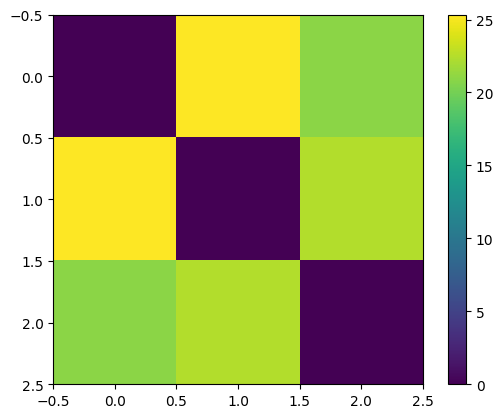

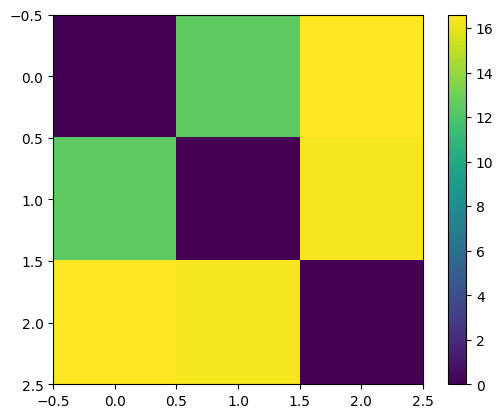

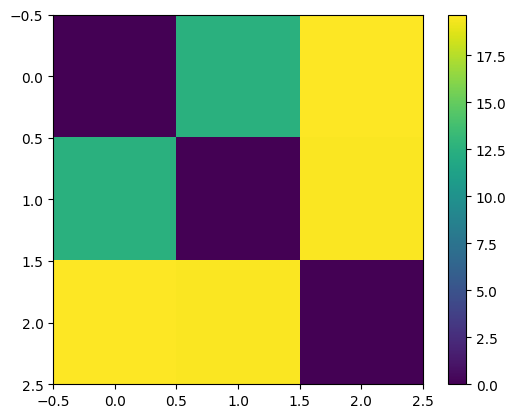

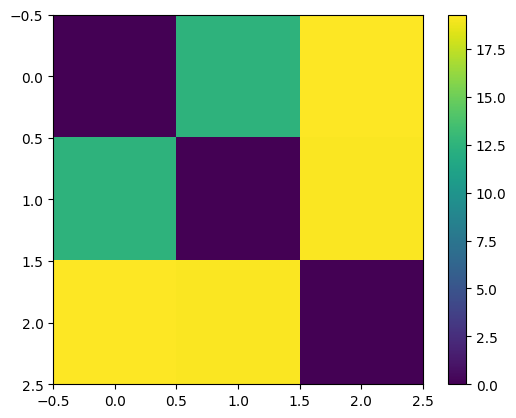

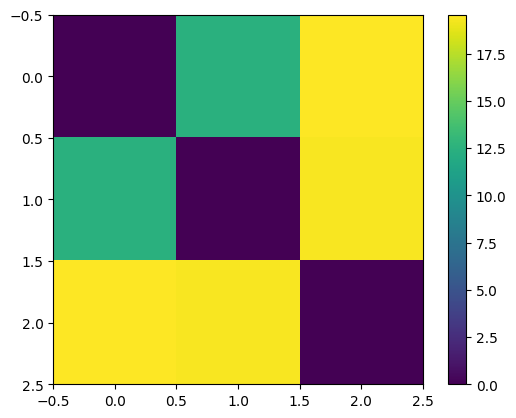

...

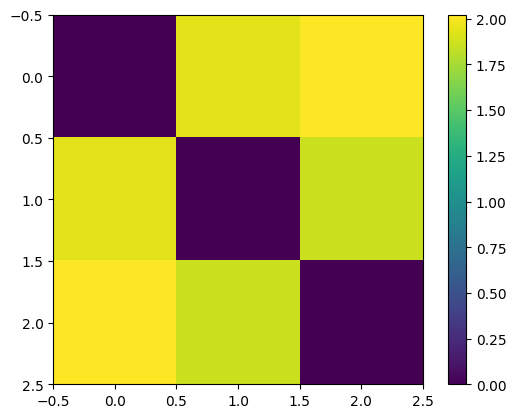

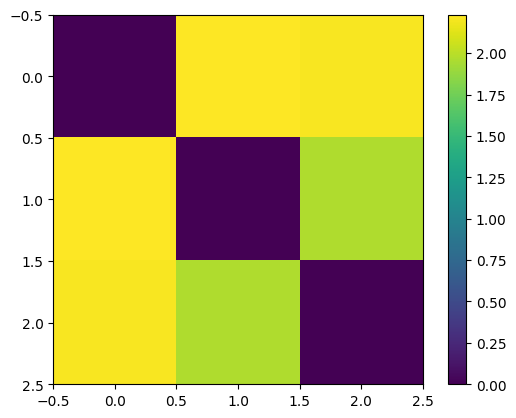

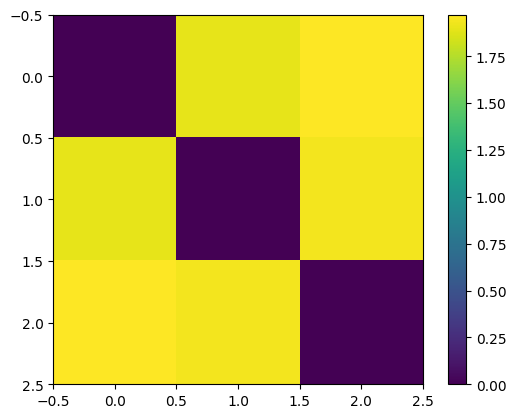

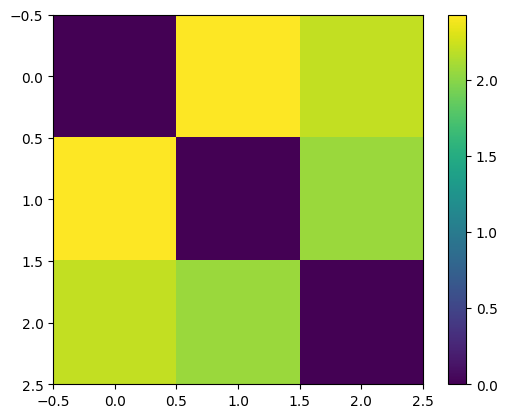

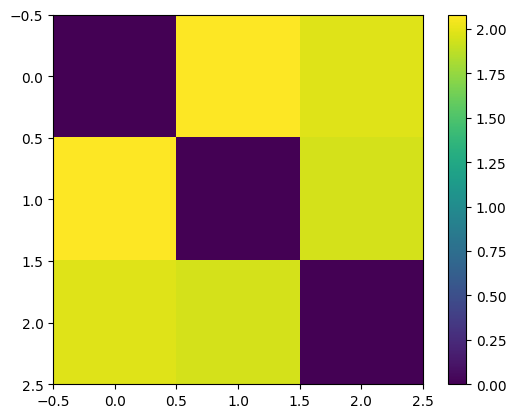

In [2]:
from __future__ import annotations

import torch
from torch import nn
import numpy as np
import matplotlib.pyplot as plt
import wandb
import os
from smac.env import StarCraft2Env
from torchrl.modules import MultiAgentMLP
from het_control.snd import compute_behavioral_distance


class ActorCritic(nn.Module):
    def __init__(self, obs_dim: int, n_agents: int, n_actions: int, hidden: list[int]):
        super().__init__()
        self.n_agents = n_agents
        self.shared = MultiAgentMLP(
            n_agent_inputs=obs_dim,
            n_agent_outputs=n_actions,
            n_agents=n_agents,
            centralised=False,
            share_params=True,
            activation_class=nn.ReLU,
            num_cells=hidden,
        )
        self.agent_mlps = MultiAgentMLP(
            n_agent_inputs=obs_dim,
            n_agent_outputs=n_actions,
            n_agents=n_agents,
            centralised=False,
            share_params=False,
            activation_class=nn.ReLU,
            num_cells=hidden,
        )
        feature_size = n_agents * n_actions
        self.critic = nn.Sequential(
            nn.Flatten(start_dim=1),
            nn.Linear(feature_size, 128),
            nn.ReLU(),
            nn.Linear(128, 1)
        )

    def forward(self, obs: torch.Tensor):
        shared_out = self.shared(obs)
        dev = self.agent_mlps(obs)
        logits = shared_out + dev
        value = self.critic(logits)
        return logits, value.squeeze(-1), dev


def render_snd_heatmap(env: StarCraft2Env, model: ActorCritic) -> plt.Figure:
    obs = env.get_obs()
    obs_tensor = torch.tensor(np.stack(obs), dtype=torch.float32).unsqueeze(0)
    dev_out = model.agent_mlps(obs_tensor).squeeze(0)
    n_agents = env.get_env_info()['n_agents']
    dist_matrix = torch.zeros((n_agents, n_agents), dtype=torch.float32)
    for i in range(n_agents):
        for j in range(n_agents):
            dist_matrix[i, j] = torch.dist(dev_out[i], dev_out[j]).item()
    fig, ax = plt.subplots()
    im = ax.imshow(dist_matrix.numpy(), interpolation='nearest')
    fig.colorbar(im, ax=ax)
    return fig


def save_checkpoint(model: ActorCritic, optimizer: torch.optim.Optimizer, step: int, path: str):
    torch.save({
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'step': step
    }, path)


def load_checkpoint(model: ActorCritic, optimizer: torch.optim.Optimizer, path: str):
    checkpoint = torch.load(path)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    return checkpoint['step']


def safe_reset(env: StarCraft2Env, max_retries: int = 3):
    """Retry env.reset() + get_obs() up to max_retries times, catching any exception."""
    n_agents = env.get_env_info()['n_agents']
    for attempt in range(1, max_retries + 1):
        try:
            env.reset()
            obs = env.get_obs()
            if obs and len(obs) == n_agents:
                return obs
            else:
                print(f"[WARNING] Reset attempt {attempt} returned {len(obs) if obs else 0} obs. Retrying...")
        except Exception as e:
            print(f"[WARNING] Reset attempt {attempt} raised {type(e).__name__}: {e}. Retrying...")
    raise RuntimeError(f"safe_reset failed after {max_retries} attempts.")


def train(env: StarCraft2Env, model: ActorCritic, config: dict):
    optimizer = torch.optim.Adam(model.parameters(), lr=config['lr'])
    gamma, lam = config['gamma'], config['gae_lambda']
    rollout = config['rollout_len']
    desired_snd = config['desired_snd']
    diversity_coef = config['diversity_coef']
    checkpoint_path = config.get('checkpoint_path', 'checkpoint.pt')

    total_steps = 0
    if os.path.exists(checkpoint_path):
        try:
            total_steps = load_checkpoint(model, optimizer, checkpoint_path)
            print(f"Resumed from checkpoint at step {total_steps}")
        except Exception as e:
            print(f"[WARNING] Checkpoint load failed: {e}\nStarting from scratch.")

    # initial reset
    try:
        obs = safe_reset(env)
    except Exception as e:
        print(f"[ERROR] Cannot start training: {e}")
        return

    while total_steps < config['target_steps']:
        obs_buf, logp_buf, val_buf, rew_buf, mask_buf = [], [], [], [], []

        for _ in range(rollout):
            obs_t = torch.tensor(np.stack(obs), dtype=torch.float32).unsqueeze(0)
            logits, value, _ = model(obs_t)
            logits = logits.squeeze(0)

            actions_list, logps = [], []
            for i in range(model.n_agents):
                avail = env.get_avail_agent_actions(i)
                mask = torch.tensor(avail, dtype=torch.bool, device=logits.device)
                logit = logits[i].masked_fill(~mask, -1e9)
                dist  = torch.distributions.Categorical(logits=logit)
                a = dist.sample()
                actions_list.append(a.item())
                logps.append(dist.log_prob(a))

            reward, done, _ = env.step(actions_list)

            # step-return validation
            try:
                next_obs = env.get_obs()
                if not next_obs or len(next_obs) != model.n_agents:
                    raise ValueError(f"got {len(next_obs) if next_obs else 0}")
            except Exception as e:
                print(f"[WARNING] Bad obs after step ({e}); resetting and skipping this step.")
                obs = safe_reset(env)
                continue

            obs_buf.append(obs_t)
            logp_buf.append(torch.stack(logps).sum())
            val_buf.append(value)
            rew_buf.append(torch.tensor([reward], dtype=torch.float32))
            mask_buf.append(torch.tensor([1.0 - done], dtype=torch.float32))

            obs = next_obs
            total_steps += 1
            if done:
                obs = safe_reset(env)

        # bootstrap value
        obs_t    = torch.tensor(np.stack(obs), dtype=torch.float32).unsqueeze(0)
        _, next_val, dev_out = model(obs_t)
        val_buf.append(next_val)
        mask_buf.append(torch.tensor([1.0], dtype=torch.float32))

        logp_arr = torch.stack(logp_buf)
        val_arr  = torch.cat(val_buf)
        rew_arr  = torch.cat(rew_buf)
        mask_arr = torch.cat(mask_buf)

        # GAE
        adv = torch.zeros_like(rew_arr)
        last = 0
        for t in reversed(range(len(rew_arr))):
            nonterm = mask_arr[t]
            delta = rew_arr[t] + gamma * val_arr[t+1] * nonterm - val_arr[t]
            last = delta + gamma * lam * nonterm * last
            adv[t] = last
        ret = adv + val_arr[:-1]

        # losses
        policy_loss = -(logp_arr * adv.detach()).mean()
        value_loss  = 0.5 * (ret.detach() - val_arr[:-1]).pow(2).mean()
        behavioral_dist_scalar = compute_behavioral_distance(dev_out.squeeze(0), just_mean=True)
        diversity_loss = (behavioral_dist_scalar - desired_snd).pow(2).mean()
        total_loss = policy_loss + config['vf_coef'] * value_loss + diversity_coef * diversity_loss

        optimizer.zero_grad()
        total_loss.backward()
        optimizer.step()

        wandb.log({
            'step': total_steps,
            'policy_loss': policy_loss.item(),
            'value_loss':  value_loss.item(),
            'diversity_loss': diversity_loss.item(),
            'behavioral_snd': behavioral_dist_scalar.pow(2).mean().item(),
            'reward': rew_arr.mean().item()
        })

        if total_steps % rollout == 0:
            save_checkpoint(model, optimizer, total_steps, checkpoint_path)
            wandb.log({'episode_behavioral_snd': behavioral_dist_scalar.pow(2).mean().item()})

        fig = render_snd_heatmap(env, model)
        wandb.log({'heatmap': wandb.Image(fig)})

    env.close()
    save_checkpoint(model, optimizer, total_steps, config.get('save_path', 'model.pt'))


def main():
    config = {
        'lr': 2.5e-4,
        'gamma': 0.99,
        'gae_lambda': 0.95,
        'rollout_len': 128,
        'vf_coef': 0.5,
        'desired_snd': 2,
        'diversity_coef': 0.6,
        'target_steps': 500000,
        'save_path': 'model.pt',
        'checkpoint_path': 'checkpoint1.pt'
    }
    wandb.init(project='smac_dico_ppo', config=config)

    env = StarCraft2Env(map_name='3m')
    info = env.get_env_info()
    print(f"obs_shape: {info['obs_shape']}, n_agents: {info['n_agents']}, n_actions: {info['n_actions']}")
    model = ActorCritic(
        obs_dim=info['obs_shape'],
        n_agents=info['n_agents'],
        n_actions=info['n_actions'],
        hidden=[64, 64]
    )
    wandb.watch(model)
    train(env, model, config)


if __name__ == '__main__':
    main()
